# Gọi thư viện cần thiết 

In [1]:
# Nhập khẩu thư viện NumPy
import numpy as np

# Nhập khẩu thư viện PIL (Python Imaging Library) để xử lý ảnh
from PIL import Image

# Nhập khẩu thư viện Matplotlib để hiển thị ảnh
import matplotlib.pyplot as plt

# Cắt và tạo mặt nạ trên ảnh 

**Cắt ảnh**

Ảnh ban đầu 

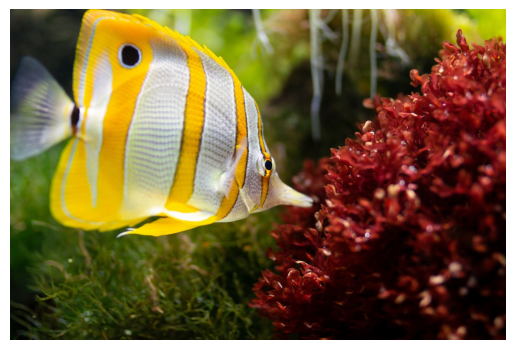

In [8]:
# Mở bức ảnh từ đường dẫn đã chỉ định
img = Image.open("/kaggle/input/data-btl-xla/images/fish.jpg")

# Hiển thị bức ảnh bằng Matplotlib
plt.imshow(img)  # Hiển thị bức ảnh đã mở
plt.axis('off')  # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.show()  # Hiển thị bức ảnh trong một cửa sổ đồ họa


Ảnh sau khi cắt

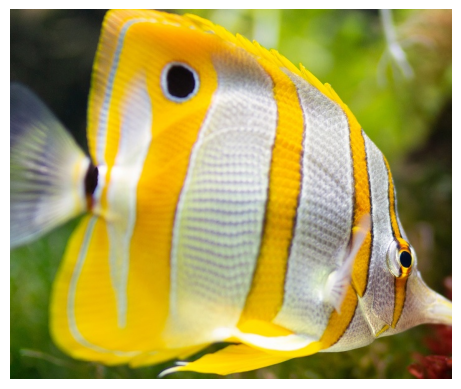

In [16]:
# Chuyển đổi bức ảnh đã mở thành mảng NumPy
np_img = np.array(img)

# Cắt một phần của mảng NumPy với chỉ số hàng từ 5 đến 599 và cột từ 40 đến 749
slice_np_img = np_img[5:600, 40:750]

# Hiển thị phần đã cắt của bức ảnh
plt.imshow(slice_np_img)  # Hiển thị phần ảnh đã cắt
plt.axis('off')  # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.show()  # Hiển thị bức ảnh đã cắt trong một cửa sổ đồ họa

**Tạo mặt nạ ảnh**

Ảnh ban đầu 

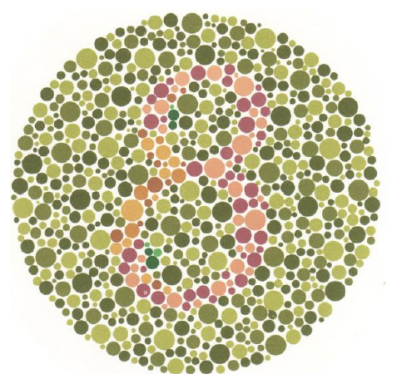

In [4]:
# Mở bức ảnh từ đường dẫn đã chỉ định
img = Image.open("/kaggle/input/data-btl-xla/images/Ishihara.png")

# Hiển thị bức ảnh bằng Matplotlib
plt.imshow(img)  # Hiển thị bức ảnh đã mở
plt.axis('off')  # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.show()  # Hiển thị bức ảnh trong một cửa sổ đồ họa

Ảnh sau khi tạo mặt nạ

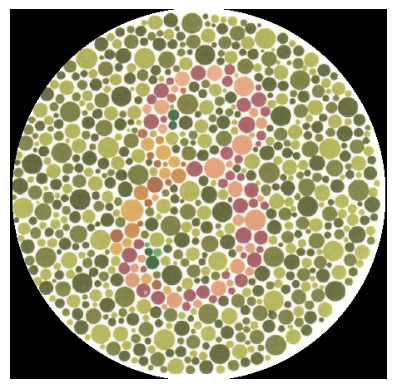

In [5]:
# Chuyển đổi bức ảnh đã mở thành mảng NumPy
np_img = np.array(img)

# Lấy kích thước của mảng ảnh: chiều cao (dx), chiều rộng (dy), và số kênh màu (_)
dx, dy, _ = np_img.shape

# Tạo lưới tọa độ cho từng pixel trong ảnh
X, Y = np.ogrid[0:dx, 0:dy]

# Tạo mặt nạ hình tròn: các pixel nằm ngoài hình tròn sẽ có giá trị True
mask = (X - dx / 2) ** 2 + (Y - dy / 2) ** 2 > dx * dy / 4

# Gán giá trị 0 (đen) cho các pixel nằm ngoài hình tròn theo mặt nạ
np_img[mask, :] = 0

# Hiển thị bức ảnh đã chỉnh sửa với mặt nạ
plt.imshow(np_img)  # Hiển thị bức ảnh đã thay đổi
plt.axis('off')  # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.show()  # Hiển thị bức ảnh trong một cửa sổ đồ họa


# Biến đổi hình ảnh đơn giản - pha trộn α của hai hình ảnh bằng cách hòa tan chéo

Hai ảnh ban đầu

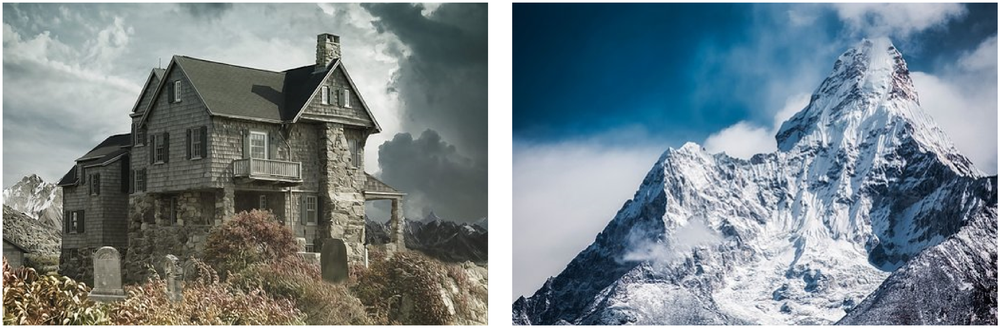

In [42]:
# Mở bức ảnh đầu tiên từ đường dẫn đã chỉ định
im1 = Image.open("/kaggle/input/data-btl-xla/images/house2.png")

# Mở bức ảnh thứ hai từ đường dẫn đã chỉ định
im2 = Image.open("/kaggle/input/data-btl-xla/images/mountain.png")

# Lấy kích thước của bức ảnh đầu tiên (im1) để sử dụng cho việc thay đổi kích thước
new_size = im1.size

# Thay đổi kích thước bức ảnh thứ hai (im2) để khớp với kích thước của im1
im2 = im2.resize(new_size)

# Tạo danh sách chứa hai bức ảnh
list_img = [im1, im2]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(2):
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 2, i + 1)
    
    # Hiển thị bức ảnh tại chỉ số i trong danh sách
    plt.imshow(list_img[i])
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')
    
# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau khi trộn

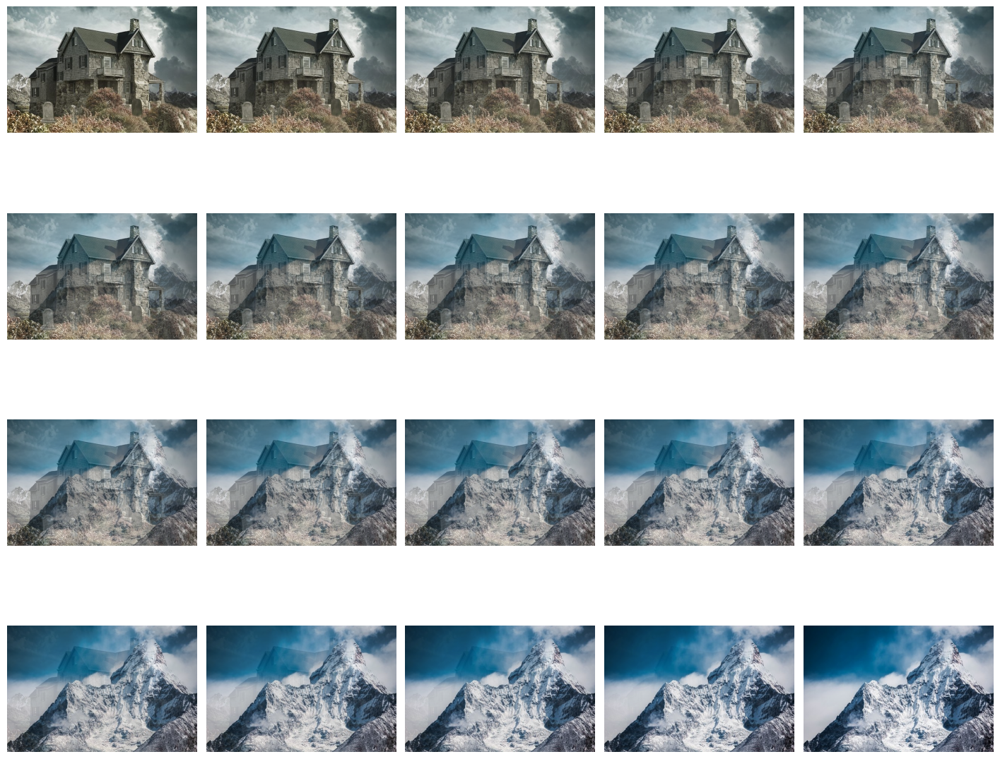

In [43]:
# Chuyển đổi bức ảnh im1 thành mảng NumPy, lấy 3 kênh đầu tiên (RGB) và chia cho 255 để đưa giá trị pixel về khoảng [0, 1]
im1 = np.array(im1)[:, :, :3] / 255 # vì ảnh 1 có 4 kênh màu mà ảnh 2 có 3 kênh màu nên để có thể trộn được 2 ảnh với nhau ta phải chuyển ảnh 1 thành 3 kênh màu

# Chuyển đổi bức ảnh im2 thành mảng NumPy và chia cho 255 để đưa giá trị pixel về khoảng [0, 1]
im2 = np.array(im2) / 255

# Khởi tạo biến đếm i để đánh số các subplot
i = 1

# Tạo một cửa sổ hiển thị với kích thước 18x15 inch
plt.figure(figsize=(18, 15))

# Vòng lặp qua các giá trị alpha từ 0 đến 1, với 20 điểm
for alpha in np.linspace(0, 1, 20):
    # Tạo một subplot cho mỗi giá trị alpha
    plt.subplot(4, 5, i)
    
    # Tính giá trị pixel của hình ảnh kết quả bằng công thức pha trộn α
    plt.imshow((1 - alpha) * im1 + alpha * im2)
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')
    
    # Tăng biến đếm i lên 1 để chuyển sang subplot tiếp theo
    i += 1
    
    # Điều chỉnh khoảng cách giữa các subplot
    plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh đã pha trộn trong cửa sổ
plt.show()


# Âm bản ảnh 

Ảnh ban đầu 

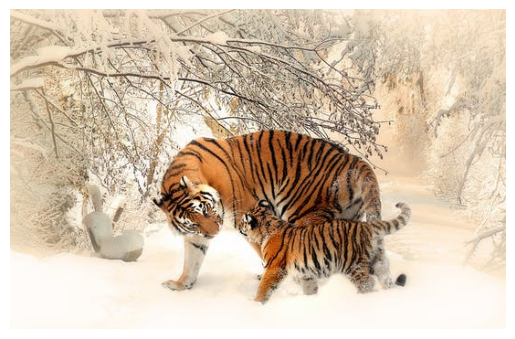

In [44]:
# Mở bức ảnh từ đường dẫn đã chỉ định
img = Image.open("/kaggle/input/data-btl-xla/images/tigers.jpeg")

# Hiển thị bức ảnh bằng Matplotlib
plt.imshow(img)  # Hiển thị bức ảnh đã mở
plt.axis('off')  # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.show()  # Hiển thị bức ảnh trong một cửa sổ đồ họa


Ảnh sau khi xử lý 

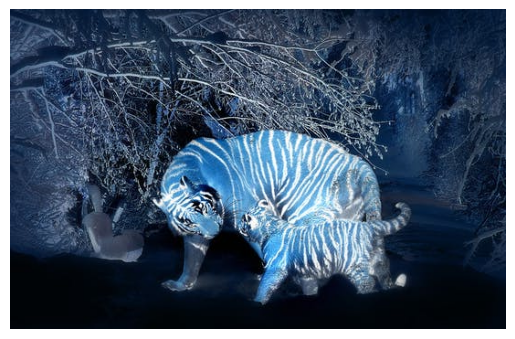

In [45]:
# Áp dụng hàm point() để đảo ngược màu sắc của bức ảnh
# Hàm lambda nhận đầu vào x (giá trị pixel) và trả về giá trị đối lập (255 - x)
im_t = img.point(lambda x: 255 - x)

# Hiển thị bức ảnh đã được đảo ngược màu sắc
plt.imshow(im_t)  # Hiển thị bức ảnh âm bản trong cửa sổ đồ họa

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')  # Điều này giúp loại bỏ các số liệu và nhãn không cần thiết quanh ảnh

# Hiển thị bức ảnh đã đảo ngược màu sắc trong một cửa sổ đồ họa
plt.show()  # Hàm này mở một cửa sổ hiển thị và làm cho ảnh được hiện ra


# Chuyển đổi ảnh thành ảnh xám

Ảnh ban dầu 

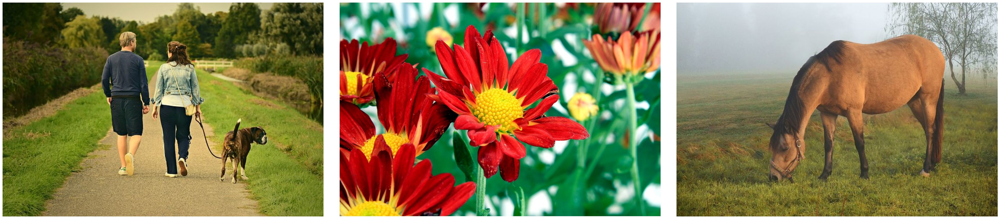

In [46]:
# Mở bức ảnh từ đường dẫn đã chỉ định
img = Image.open("/kaggle/input/data-btl-xla/images/men_dog.jpg")
img1 = Image.open("/kaggle/input/data-btl-xla/images/flowers.jpg")
img2 = Image.open("/kaggle/input/data-btl-xla/images/horses.jpg")

# Tạo danh sách chứa các bức ảnh
list_img = [img, img1, img2]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(3):
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh tại chỉ số i trong danh sách
    plt.imshow(list_img[i])
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')
    
# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()


Ảnh sau khi xử lý 

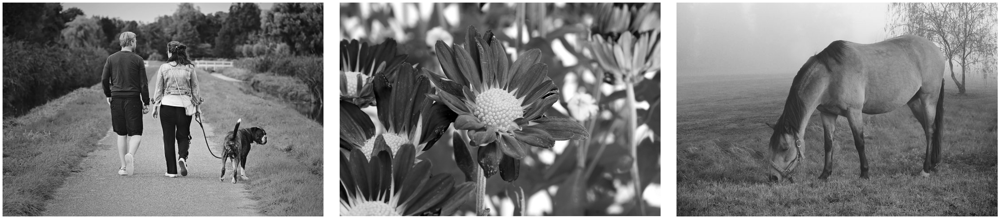

In [47]:
# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))  # Kích thước cửa sổ hiển thị là 50x30 inch

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(3):  # Lặp qua 3 bức ảnh (giả định rằng list_img có 3 phần tử)
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)  # Lưới 1 hàng và 3 cột, chọn cột thứ i + 1

    # Hiển thị bức ảnh tại chỉ số i trong danh sách dưới dạng ảnh xám
    plt.imshow(list_img[i].convert('L'), cmap='gray')  # Chuyển đổi bức ảnh thành xám và sử dụng cmap 'gray'

    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')  # Ẩn các nhãn và giá trị trên các trục

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)  # Thiết lập khoảng cách giữa các subplot

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()  # Mở cửa sổ hiển thị và hiện các bức ảnh


# Biến đổi các mức xám

**Biến đổi log**

Ảnh ban đầu 

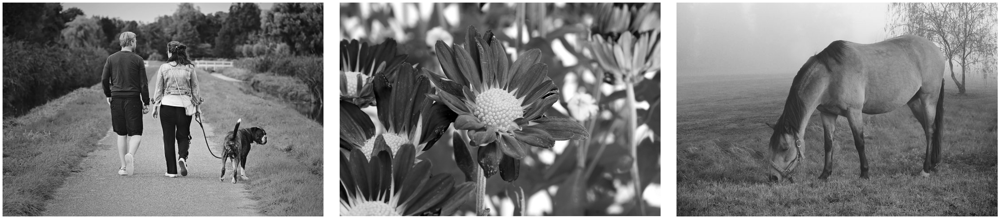

In [48]:
# Mở bức ảnh từ đường dẫn đã chỉ định
img = Image.open("/kaggle/input/data-btl-xla/images/men_dog.jpg")
img1 = Image.open("/kaggle/input/data-btl-xla/images/flowers.jpg")
img2 = Image.open("/kaggle/input/data-btl-xla/images/horses.jpg")

# Tạo danh sách chứa các bức ảnh
list_img = [img, img1, img2]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(3):
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh tại chỉ số i trong danh sách
    plt.imshow(list_img[i].convert('L'), cmap='gray')
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')
    
# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()


Ảnh sau khi xử lý 

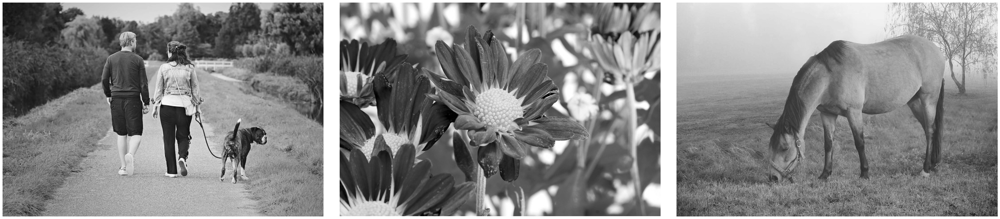

In [49]:
# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))  # Kích thước cửa sổ hiển thị là 50x30 inch

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(3):  # Lặp qua 3 bức ảnh (giả định rằng list_img có 3 phần tử)
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)  # Lưới 1 hàng và 3 cột, chọn cột thứ i + 1

    # Hiển thị bức ảnh tại chỉ số i trong danh sách, áp dụng biến đổi log và chuyển đổi thành ảnh xám
    plt.imshow(list_img[i].point(lambda x: 255 * np.log(1 + x / 255)).convert('L'), cmap='gray')  
    # Sử dụng cmap 'gray' để hiển thị ảnh xám

    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')  # Ẩn các nhãn và giá trị trên các trục

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)  # Thiết lập khoảng cách giữa các subplot

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()  # Mở cửa sổ hiển thị và hiện các bức ảnh


**Biến đổi lũy thừa**

Ảnh ban đầu 

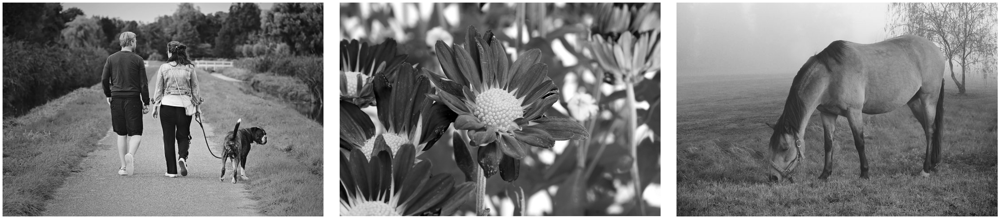

In [50]:
# Mở bức ảnh từ đường dẫn đã chỉ định
img = Image.open("/kaggle/input/data-btl-xla/images/men_dog.jpg")
img1 = Image.open("/kaggle/input/data-btl-xla/images/flowers.jpg")
img2 = Image.open("/kaggle/input/data-btl-xla/images/horses.jpg")

# Tạo danh sách chứa các bức ảnh
list_img = [img, img1, img2]

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(3):
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)
    
    # Hiển thị bức ảnh tại chỉ số i trong danh sách
    plt.imshow(list_img[i].convert('L'), cmap='gray')
    
    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')
    
# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()

Ảnh sau khi xử lý 

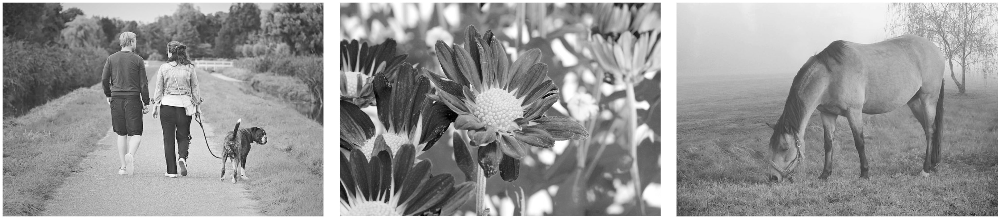

In [51]:
# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(50, 30))  # Kích thước cửa sổ hiển thị là 50x30 inch

# Vòng lặp để hiển thị từng bức ảnh trong danh sách
for i in range(3):  # Lặp qua 3 bức ảnh (giả định rằng list_img có 3 phần tử)
    # Tạo một subplot cho mỗi bức ảnh
    plt.subplot(1, 3, i + 1)  # Lưới 1 hàng và 3 cột, chọn cột thứ i + 1

    # Hiển thị bức ảnh tại chỉ số i trong danh sách, áp dụng biến đổi lũy thừa và chuyển đổi thành ảnh xám
    plt.imshow(list_img[i].point(lambda x: 255 * (x / 255) ** 0.6).convert('L'), cmap='gray')  
    # Áp dụng biến đổi lũy thừa với gamma = 0.6 và chuyển đổi ảnh thành xám

    # Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
    plt.axis('off')  # Ẩn các nhãn và giá trị trên các trục

# Điều chỉnh khoảng cách giữa các subplot
plt.subplots_adjust(wspace=0.05, hspace=0.05)  # Thiết lập khoảng cách giữa các subplot

# Hiển thị tất cả các bức ảnh trong cửa sổ
plt.show()  # Mở cửa sổ hiển thị và hiện các bức ảnh
